# Tugas Analisis Multimedia: Audio, Gambar, Video

**Mata Kuliah:** Sistem & Teknologi Multimedia  
**Nama:** Reynaldi Cristian Simamora   
**NIM:** 122140116  

---

## Deskripsi Tugas

Tugas ini bertujuan untuk memahami representasi dasar data multimedia (audio, gambar, dan video) melalui praktik langsung memuat data, visualisasi, dan ekstraksi informasi fundamental. Anda akan bekerja dengan tiga jenis media berbeda untuk menganalisis karakteristik temporal (audio), spasial (gambar), dan spatio-temporal (video).

Fokus tugas adalah pada pemahaman konsep dasar representasi multimedia dan kemampuan interpretasi hasil visualisasi, **bukan** pada manipulasi atau transformasi lanjutan data multimedia.

---

## ⚠️ CATATAN PENTING: PRESENTASI ACAK & KEJUJURAN AKADEMIK

**Sebagian mahasiswa akan dipilih secara ACAK untuk presentasi singkat** (5-10 menit) menjelaskan kode dan interpretasi hasil mereka. Jika Anda:
- Tidak mampu menjelaskan kode yang Anda kumpulkan
- Hanya menyalin-tempel tanpa pemahaman
- Bergantung sepenuhnya pada AI tanpa memahami konsep

**Maka nilai tugas Anda akan diberikan 0 (nol).**

Gunakan referensi dan AI sebagai alat bantu pembelajaran, tetapi pastikan Anda memahami setiap baris kode dan dapat menjelaskan logika di baliknya.

In [5]:
# Import Library (Satu-satunya sel kode dalam template ini)
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
from PIL import Image
import cv2
from IPython.display import Audio, HTML, display
import os

# Set matplotlib untuk menampilkan plot inline
%matplotlib inline

# Tampilkan versi library untuk dokumentasi
print("Library versions:")
print(f"NumPy: {np.__version__}")
print(f"Matplotlib: {matplotlib.__version__}")
print(f"Librosa: {librosa.__version__}")
print(f"OpenCV: {cv2.__version__}")

# Tambahkan import lain jika diperlukan saat mengerjakan tugas

Library versions:
NumPy: 2.2.6
Matplotlib: 3.10.6
Librosa: 0.11.0
OpenCV: 4.12.0


## Petunjuk Umum Pengerjaan

### 📋 Cara Menggunakan Template
- Gunakan notebook ini sebagai kerangka kerja utama
- Tulis penjelasan (markdown) **SEBELUM** menaruh kode agar maksud dan tujuan jelas
- Tambahkan sel kode di tempat yang sudah disediakan (tandai dengan TODO)
- Semua plot/gambar harus diberi judul, label sumbu, dan keterangan singkat

### 📊 Standar Visualisasi
- Setiap plot harus memiliki judul yang deskriptif
- Label sumbu X dan Y harus jelas
- Gunakan colorbar untuk plot yang memerlukan skala warna
- Berikan interpretasi singkat setelah setiap visualisasi

### 📂 Struktur Data yang Direkomendasikan
- Buat folder `data/` di direktori yang sama dengan notebook
- Gunakan nama file yang deskriptif (contoh: `audio_musik_piano.wav`, `gambar_pemandangan_gunung.jpg`)
- Dokumentasikan sumber data jika menggunakan dataset publik

### ⚠️ Larangan
- **Jangan** menaruh seluruh pekerjaan dalam satu sel kode yang sangat panjang
- **Jangan** menempel hasil output tanpa interpretasi atau analisis
- **Jangan** bergantung sepenuhnya pada AI - pahami dan kuasai kode Anda

### 🎯 Persiapan Presentasi Acak
- Pastikan Anda memahami setiap baris kode yang ditulis
- Latih menjelaskan logika dan alur pemikiran Anda
- Siapkan penjelasan untuk setiap visualisasi dan interpretasinya

    ## Checklist Kelengkapan (Centang ✅ saat selesai)

    ### 🎵 Bagian Audio
    - [✅] Muat audio dan tampilkan metadata (durasi, sample rate, jumlah kanal)
    - [✅] Tampilkan waveform dengan label sumbu yang jelas
    - [✅] Tampilkan spectrogram dalam skala log-dB dengan colorbar
    - [✅] Tampilkan MFCC (minimal 13 koefisien) sebagai heatmap
    - [✅] Berikan interpretasi dan analisis untuk setiap visualisasi audio

    ### 🖼️ Bagian Gambar
    - [✅] Tampilkan gambar dengan benar dalam format RGB
    - [✅] Tampilkan informasi dasar (dimensi, jumlah kanal, dtype)
    - [✅] Tampilkan histogram warna untuk channel R, G, B
    - [✅] Berikan analisis hubungan histogram dengan kesan visual gambar

    ### 📹 Bagian Video
    - [✅] Tampilkan metadata video (resolusi, fps, frame count, durasi)
    - [✅] Tampilkan 3 frame representatif (awal, tengah, akhir)
    - [✅] Konversi BGR ke RGB dengan benar untuk visualisasi
    - [✅] Analisis kesesuaian parameter video dengan use case

    ### 📝 Analisis & Dokumentasi
    - [✅] Setiap bagian memiliki interpretasi dan analisis ringkas
    - [✅] Perbandingan representasi ketiga jenis media
    - [✅] Kesimpulan pembelajaran dan refleksi
    - [✅] Semua sumber data dan referensi dicantumkan

# Pendahuluan

## Apa itu Data Multimedia?

Data multimedia adalah informasi yang dikodekan dalam berbagai format untuk merepresentasikan dunia nyata:

- **Audio (1D)**: Sinyal satu dimensi yang berubah terhadap waktu
  - Contoh: musik, suara, speech
  - Representasi: amplitudo vs waktu
  
- **Gambar (2D)**: Matriks nilai intensitas dalam ruang dua dimensi
  - Contoh: foto, ilustrasi, grafik
  - Representasi: intensitas pixel pada koordinat (x,y)
  
- **Video (2D + Waktu)**: Rangkaian frame (gambar) yang ditampilkan berurutan
  - Contoh: film, rekaman, animasi
  - Representasi: frame berubah terhadap waktu dengan frame rate tertentu

## Tujuan Tugas

Memahami representasi dasar dan teknik visualisasi fundamental untuk setiap jenis media multimedia, termasuk:
- Cara memuat dan membaca file multimedia
- Ekstraksi informasi metadata yang penting
- Visualisasi yang informatif dan mudah dipahami
- Interpretasi hasil analisis secara kontekstual

## Cara Kerja

1. Isi setiap bagian sesuai instruksi yang diberikan
2. Tambahkan sel kode di tempat yang ditandai dengan "TODO"
3. Berikan interpretasi dan analisis setelah setiap visualisasi
4. Pastikan semua plot memiliki judul, label, dan keterangan yang jelas

# Bagian A — Audio

### A1. Deskripsi Data

**TODO:** Jelaskan audio yang akan Anda analisis:
- Jenis audio: Musik "Don't let me down" By The Beatles.
- Sumber: Youtube (https://youtu.be/NCtzkaL2t_Y?si=jNO76JsGKMXRTVe9).
- Format file: .wav
- Alasan pemilihan: Saya ingin melihat informasi data audio dari musik yang saya sukai.

Audio yang saya gunakan adalah audio musik berjudul Don't Let Me Down karya band The BEatles. Saya mengambil medianya dari kanal
youtube resmi dari The Beatles. Format media audio-nya adalah wav karena sudah jadi standar format yang biasa digunakan dan lebih
baik dibanding mp3. Mengapa memilih audio ini, saya ingin mendalami informasi lagu ini terutama beatnya.

**Path file:** `data/audio.wav` (isi nama file Anda nanti di kode)

---

### A2. TODO: Muat & Metadata

**Instruksi:**
Tulis kode untuk memuat file audio dan menampilkan metadata dasar:
- Sample rate (Hz)
- Durasi (detik)
- Jumlah kanal (mono/stereo)
- Jumlah total sampel

**Catatan:** Jika file MP3 bermasalah saat loading, gunakan format WAV sebagai alternatif.

---

Penjelasan Kode Di Bawah

Kode di bawah adalah kode untuk inisiasi awal media untuk dapat diolah. 
Untuk inisiasi awal dari path medianya, yaitu menngampil path lokal dari data/audio.wav.
Kemudian akan dimuat audionya dengan 'try' jika bisa akan mengeluarkan keluaran berhasil
dan jika tidak akan menampilkan tipe error yang muncul.
Kemudian ada proses konversi stereo ke mono, untuk memudahkan proses analisa,
dengan mencari rata-rata titik sample masing masing kanal.

---


In [15]:
# Memuat Audio dengan Sistem Fallback
PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'audio.wav')

# Variabel untuk menyimpan hasil
y = None
sr = None
source_info = ""

# Opsi 1: Coba muat file lokal
try:
    if os.path.exists(PATH_AUDIO):
        y, sr = librosa.load(PATH_AUDIO, sr=None)  # sr=None untuk mempertahankan sample rate asli
        source_info = f"✅ Berhasil memuat: {PATH_AUDIO}"
    else:
        raise FileNotFoundError("File tidak ditemukan")
except:
    print(f"⚠️ Tidak dapat memuat {PATH_AUDIO}")
    
    # Opsi 2: Gunakan contoh bawaan librosa
    try:
        y, sr = librosa.load(librosa.ex('trumpet'), sr=None)
        source_info = "✅ Menggunakan contoh audio bawaan librosa (trumpet)"
    except:
        print("⚠️ Contoh librosa tidak tersedia")

# Konversi ke mono jika stereo
if y.ndim > 1:
    y = np.mean(y, axis=0)  # Rata-rata semua kanal
    source_info += " - Dikonversi ke mono"

# Pastikan tipe data float32 untuk efisiensi
y = y.astype(np.float32)

print(source_info)
print(f"📊 Shape data: {y.shape}")
print(f"🎵 Sample rate: {sr} Hz")

✅ Berhasil memuat: f:\mulmed\data\audio.wav
📊 Shape data: (10138576,)
🎵 Sample rate: 48000 Hz


---
Dari output yang diperlihatkan data berhasil dimuat, dan bentuk data atau jumlah titik samplenya adalah 10.138.576 titik sample, Dengan sample rate atau titik sample perdetik 48000. Yang artinya jumlah durasi dari audio ini adalah 211,22 detik.

---

Kode di bawah bertujuan untuk melakukan analisis metadata dan kualitas sinyal audio.
Dimana pertama akan menampilkan informasi jumlah sample, sample rate, estimasi durasi, audio, jumlah kanal, dan tipe data yang digunakan. Kemudin ada analisis amplitudo, dan pengecekan audio yang mengalami clipping.

---

In [16]:
# Analisis Metadata Audio
print("📋 METADATA AUDIO")
print("=" * 40)
print(f"🔢 Jumlah sampel: {len(y):,}")
print(f"🎵 Sample rate: {sr:,} Hz")
print(f"⏱️ Durasi: {len(y)/sr:.2f} detik")
print(f"📻 Jumlah kanal: {'Mono (1 kanal)' if y.ndim == 1 else f'Multi-kanal ({y.ndim} kanal)'}")
print(f"📊 Tipe data: {y.dtype}")
print()
print("📈 STATISTIK AMPLITUDO")
print("=" * 40)
print(f"🔽 Nilai minimum: {np.min(y):.4f}")
print(f"🔼 Nilai maksimum: {np.max(y):.4f}")
print(f"📊 Nilai rata-rata: {np.mean(y):.4f}")
print(f"📏 Standar deviasi: {np.std(y):.4f}")

# Cek apakah audio terlalu keras (clipping)
if np.abs(y).max() >= 0.99:
    print("⚠️ PERINGATAN: Audio mungkin mengalami clipping (terlalu keras)")
else:
    print("✅ Audio dalam range amplitudo yang sehat")

📋 METADATA AUDIO
🔢 Jumlah sampel: 10,138,576
🎵 Sample rate: 48,000 Hz
⏱️ Durasi: 211.22 detik
📻 Jumlah kanal: Mono (1 kanal)
📊 Tipe data: float32

📈 STATISTIK AMPLITUDO
🔽 Nilai minimum: -1.0000
🔼 Nilai maksimum: 1.0000
📊 Nilai rata-rata: 0.0000
📏 Standar deviasi: 0.2324
⚠️ PERINGATAN: Audio mungkin mengalami clipping (terlalu keras)


### A3. TODO: Waveform

**Instruksi:**
Plot waveform audio dengan:
- Sumbu X: 211 Detik
- Sumbu Y: amplitudo (-1 hingga 1)
- Waveform seluruh audio dan waveform bagian chorus dari 0 hingga 27 detik

**Analisis yang diperlukan:**
Jelaskan apa yang Anda lihat dari waveform (pola amplitudo, bagian keras/pelan, dll.)

---

Penjelasan Kode 
Kode yang disajikan bertujuan untuk melakukan visualisasi bentuk gelombang (waveform) audio dalam dua tingkat detail. Pertama, dibuat vektor waktu yang disesuaikan dengan jumlah sampel audio sehingga sumbu horizontal pada grafik dapat merepresentasikan durasi dalam satuan detik. Visualisasi dilakukan dalam dua subplot.

Subplot pertama menampilkan waveform lengkap sepanjang durasi total audio (±211 detik) sehingga memberikan gambaran umum dinamika amplitudo sinyal. Pada bagian ini juga ditambahkan anotasi berupa informasi durasi total sebagai keterangan tambahan.

Subplot kedua menampilkan visualisasi detail pada sebagian kecil sinyal, yaitu pada rentang 0–27 detik. Tujuan dari zoom ini adalah untuk memperlihatkan pola osilasi sinyal audio pada level sampel sehingga struktur getaran dasar dapat diamati lebih jelas. Pada plot ini disertakan pula anotasi mengenai jumlah sampel yang divisualisasikan.

C:\Users\ANSEN\AppData\Local\Temp\ipykernel_3808\3130596663.py:39: UserWarning: Glyph 127925 (\N{MUSICAL NOTE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\ANSEN\AppData\Local\Temp\ipykernel_3808\3130596663.py:39: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\ANSEN\.conda\envs\multimedia\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 127925 (\N{MUSICAL NOTE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\ANSEN\.conda\envs\multimedia\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


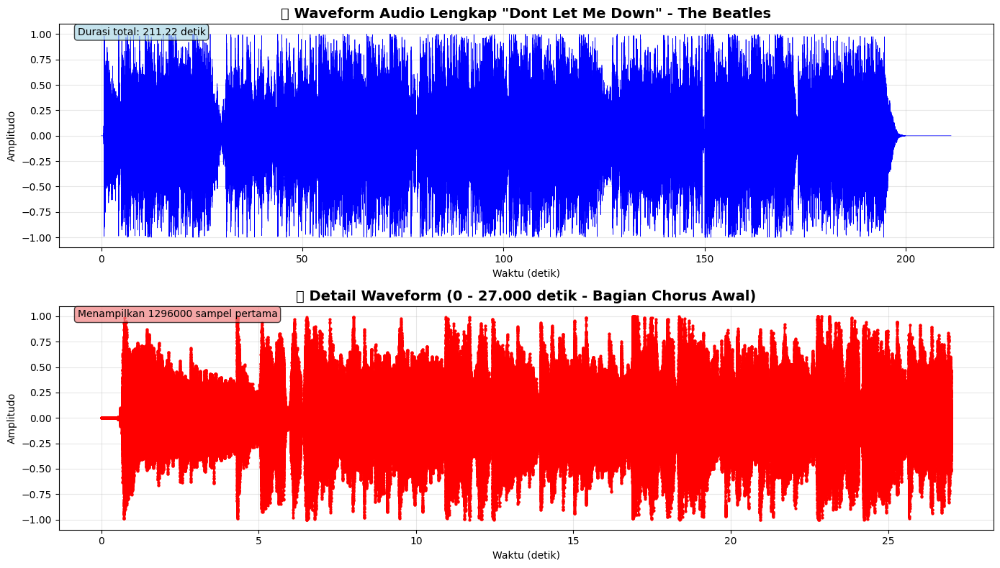

✅ Waveform berhasil ditampilkan!
📊 Total sampel yang diplot: 10,138,576
🔍 Sampel zoom detail: 1296000


In [17]:
# Plot Waveform dengan Detail Zoom
# Buat vektor waktu
t = np.linspace(0, len(y)/sr, len(y))

# Setup plot dengan 2 subplot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 8))

# Plot 1: Waveform lengkap
ax1.plot(t, y, color='blue', linewidth=0.5)
ax1.set_title('🎵 Waveform Audio Lengkap "Dont Let Me Down" - The Beatles', fontsize=14, fontweight='bold')
ax1.set_xlabel('Waktu (detik)')
ax1.set_ylabel('Amplitudo')
ax1.grid(True, alpha=0.3)
ax1.set_ylim([-1.1, 1.1])

# Tambahkan informasi durasi
duration_text = f'Durasi total: {len(y)/sr:.2f} detik'
ax1.text(0.02, 0.95, duration_text, transform=ax1.transAxes, 
         bbox=dict(boxstyle="round,pad=0.3", facecolor="lightblue", alpha=0.7))

# Plot 2: Zoom detail 0-27 detik
zoom_duration = min(27, (len(y)/sr))
zoom_samples = int(zoom_duration * sr)
t_zoom = t[:zoom_samples]
y_zoom = y[:zoom_samples]

ax2.plot(t_zoom, y_zoom, color='red', linewidth=1.5, marker='o', markersize=2)
ax2.set_title(f'🔍 Detail Waveform (0 - {zoom_duration:.3f} detik - Bagian Chorus Awal)', fontsize=14, fontweight='bold')
ax2.set_xlabel('Waktu (detik)')
ax2.set_ylabel('Amplitudo')
ax2.grid(True, alpha=0.3)
ax2.set_ylim([-1.1, 1.1])

# Tambahkan informasi zoom
zoom_text = f'Menampilkan {zoom_samples} sampel pertama'
ax2.text(0.02, 0.95, zoom_text, transform=ax2.transAxes,
         bbox=dict(boxstyle="round,pad=0.3", facecolor="lightcoral", alpha=0.7))

plt.tight_layout()
plt.show()

print(f"✅ Waveform berhasil ditampilkan!")
print(f"📊 Total sampel yang diplot: {len(y):,}")
print(f"🔍 Sampel zoom detail: {zoom_samples}")

In [18]:
# Memutar Audio di Notebook
print("🔊 Audio Player - Pastikan volume tidak terlalu keras!")
print(f"🎵 Durasi: {len(y)/sr:.2f} detik")
print(f"📻 Sample rate: {sr} Hz")
print("▶️ Klik tombol play di bawah untuk mendengar audio:")

# Tampilkan audio player
Audio(y, rate=sr)

🔊 Audio Player - Pastikan volume tidak terlalu keras!
🎵 Durasi: 211.22 detik
📻 Sample rate: 48000 Hz
▶️ Klik tombol play di bawah untuk mendengar audio:


### A4. TODO: Spectrogram log-dB

**Instruksi:**
Hitung STFT dan tampilkan spectrogram dalam skala log-dB:
- Gunakan parameter standar (n_fft=1024, hop_length=256)
- Tampilkan dengan colorbar
- Label sumbu: waktu (detik) dan frekuensi (Hz)

---

Di bawah ini adalah kode untuk menghitung stft dan mentranformasikan data menjadi spectogram

---

C:\Users\ANSEN\AppData\Local\Temp\ipykernel_3808\3249426224.py:34: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\ANSEN\.conda\envs\multimedia\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


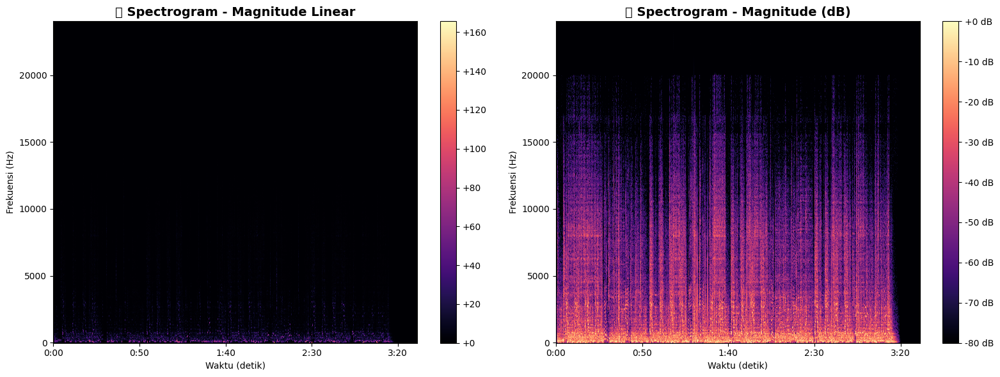

📋 INFORMASI STFT
🔢 Ukuran FFT          : 1024
👣 Hop length          : 256
🪟 Window function     : hann
📊 Shape magnitude     : (513, 39604)
⏱️ Resolusi waktu      : 5.3 ms per frame
🎵 Resolusi frekuensi  : 46.9 Hz per bin
📈 Range magnitude (dB): -80.0 – 0.0


In [23]:
# Hitung dan Plot Spectrogram (STFT)

# Parameter STFT
n_fft = 1024          # Ukuran FFT window
hop_length = 256      # Langkah antar frame
window = 'hann'       # Jenis window function

# Hitung STFT
D = librosa.stft(y, n_fft=n_fft, hop_length=hop_length, window=window)
magnitude = np.abs(D)
magnitude_db = librosa.amplitude_to_db(magnitude, ref=np.max)

# Setup plot dengan 2 subplot
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot 1: Magnitude Spectrogram (Linear)
img1 = librosa.display.specshow(
    magnitude, sr=sr, hop_length=hop_length, x_axis='time', y_axis='hz', ax=axes[0]
)
axes[0].set_title('📊 Spectrogram - Magnitude Linear', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Waktu (detik)')
axes[0].set_ylabel('Frekuensi (Hz)')
plt.colorbar(img1, ax=axes[0], format='%+2.0f')

# Plot 2: Magnitude Spectrogram (Log dB)
img2 = librosa.display.specshow(
    magnitude_db, sr=sr, hop_length=hop_length, x_axis='time', y_axis='hz', ax=axes[1]
)
axes[1].set_title('📊 Spectrogram - Magnitude (dB)', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Waktu (detik)')
axes[1].set_ylabel('Frekuensi (Hz)')
plt.colorbar(img2, ax=axes[1], format='%+2.0f dB')

plt.tight_layout()
plt.show()

# Informasi STFT
print("📋 INFORMASI STFT")
print("=" * 40)
print(f"🔢 Ukuran FFT          : {n_fft}")
print(f"👣 Hop length          : {hop_length}")
print(f"🪟 Window function     : {window}")
print(f"📊 Shape magnitude     : {magnitude.shape}")
print(f"⏱️ Resolusi waktu      : {hop_length/sr*1000:.1f} ms per frame")
print(f"🎵 Resolusi frekuensi  : {sr/n_fft:.1f} Hz per bin")
print(f"📈 Range magnitude (dB): {magnitude_db.min():.1f} – {magnitude_db.max():.1f}")


---

Tujuan Analisis
Analisis sinyal audio menggunakan Short-Time Fourier Transform (STFT) bertujuan untuk memetakan distribusi energi frekuensi sinyal terhadap waktu. Berbeda dengan waveform yang hanya menyajikan amplitudo terhadap waktu, STFT membagi sinyal menjadi potongan-potongan kecil (frame) menggunakan fungsi jendela (window function), lalu menghitung spektrum frekuensi untuk setiap frame tersebut. Pendekatan ini memungkinkan pemantauan perubahan komposisi frekuensi sepanjang durasi sinyal.

Parameter STFT yang Digunakan
Berikut adalah parameter yang digunakan dalam analisis STFT

Ukuran FFT (n 
fft
​
 ): Ukuran Fast Fourier Transform diatur sebesar 1024 sampel, yang menentukan resolusi frekuensi. Dengan laju sampel 48 kHz, resolusi frekuensi yang dihasilkan adalah sekitar 46,9 Hz per bin (48000/1024), yang cukup detail untuk membedakan frekuensi dalam audio.

Panjang Hop (hop 
length
​
 ): Parameter ini diatur sebesar 256 sampel, yang menentukan seberapa sering perhitungan spektrum dilakukan. Dengan laju sampel 48 kHz, resolusi waktu per frame adalah sekitar 5,3 ms (256/48000), yang memungkinkan deteksi perubahan sinyal yang cepat.

Fungsi Jendela (Window Function): Fungsi Hann digunakan untuk mengurangi spectral leakage akibat pemotongan sinyal menjadi frame. Fungsi ini dipilih karena menawarkan keseimbangan yang optimal antara resolusi waktu dan frekuensi.

Interpretasi Spektrogram
Visualisasi spektrogram menyajikan informasi kunci berikut:

Sumbu Horizontal (Sumbu-X): Mewakili waktu dalam detik, menunjukkan durasi total audio sekitar 3 menit 20 detik.

Sumbu Vertikal (Sumbu-Y): Menunjukkan frekuensi dalam Hertz (Hz), dari 0 Hz (bass) hingga 24 kHz (treble), yang merupakan setengah dari laju sampel (48000 Hz).

Warna (Colormap): Merepresentasikan besar energi pada frekuensi tertentu di setiap titik waktu. Untuk meningkatkan visibilitas energi amplitudo kecil, digunakan skala logaritmik (desibel/dB) karena skala linear cenderung didominasi oleh nilai-nilai yang besar.

Perbedaan Informasi Visualisasi
Tiga jenis visualisasi digunakan untuk membandingkan penyajian data:

Waveform: Hanya menampilkan perubahan amplitudo sinyal terhadap waktu dan tidak menyertakan informasi frekuensi.

Spektrogram (Skala Linear): Memperlihatkan distribusi energi frekuensi, namun kurang informatif karena detail energi kecil sulit terlihat.

Spektrogram (Skala Logaritmik/dB): Lebih cocok untuk analisis audio karena mereplikasi cara pendengaran manusia. Skala ini memungkinkan detail energi kecil terlihat jelas, memberikan representasi yang lebih akurat dari komposisi frekuensi sinyal.

Jika dilihat sebenarnya saya masih mengambil kesimpulan frekuensi tertinggi juga ditandai dengan db atau tingkat kenyaringan suara menandakan suara simbal drum, sehingga berkorelasi dengan waveform hanya saja data di plot spectogram lebih jelas karena ada frekuensi dan db.

---



### A5. TODO: MFCC

**Instruksi:**
Hitung dan tampilkan minimal 13 koefisien MFCC sebagai heatmap:
- Sumbu X: waktu (frame)
- Sumbu Y: koefisien MFCC (1-13)
- Gunakan colorbar dan judul yang jelas

**Analisis yang diperlukan:**
Interpretasi sederhana: apakah pola MFCC stabil atau berubah-ubah? Apa potensi maknanya?


---

Penjelasan singkat kode 

Kode berikut akan melakukan perhitungan Mel-Spectrogram dan MFCC, untuk representasi spektral yang lebih dekat dengan manusia mendengar suara. Mel-Spectogram akan menghitung distribusi energi frekuensi dalam mel (frekuensi persepsi telinga manusia) dan akan diturunkan dengan MFCC untuk merangkum pola spektral menjadi numerik yang ringkas

---

C:\Users\ANSEN\AppData\Local\Temp\ipykernel_3808\4280952748.py:34: UserWarning: Glyph 127926 (\N{MULTIPLE MUSICAL NOTES}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\ANSEN\AppData\Local\Temp\ipykernel_3808\4280952748.py:34: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\ANSEN\.conda\envs\multimedia\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 127926 (\N{MULTIPLE MUSICAL NOTES}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\ANSEN\.conda\envs\multimedia\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


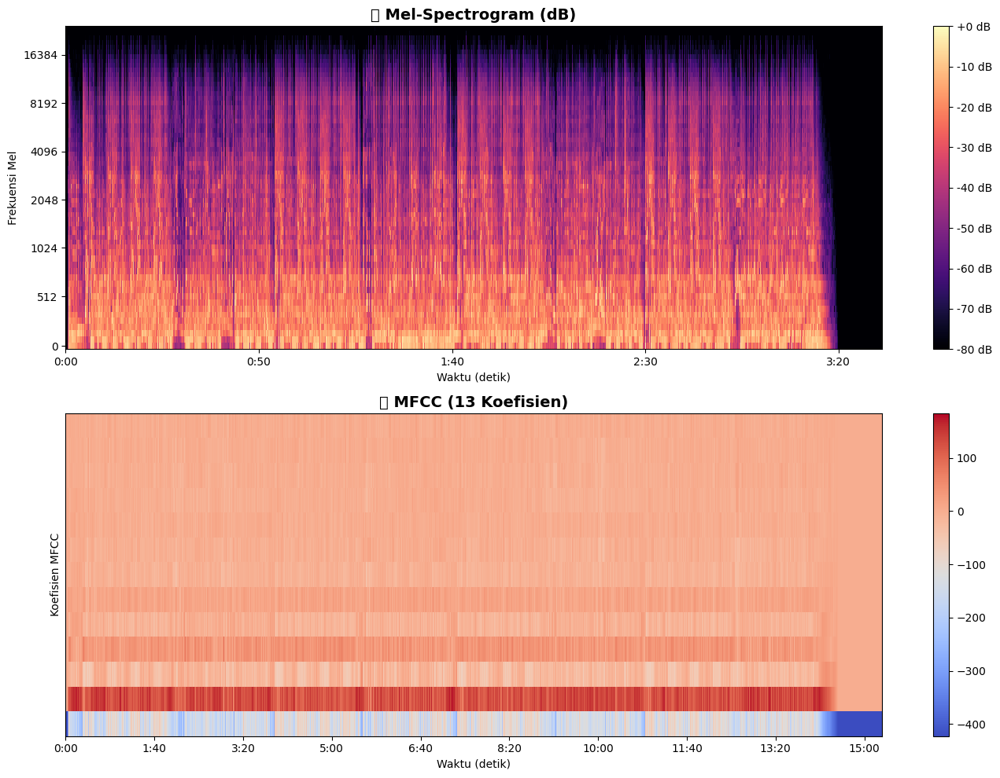

📋 INFORMASI MEL-SPECTROGRAM & MFCC
🎶 Jumlah Mel bins: 64
🎯 Jumlah MFCC: 13
📊 Shape Mel-spectrogram: (64, 39604)
📊 Shape MFCC: (13, 39604)
📈 Range Mel-spectrogram (dB): -80.0 - 0.0
📈 Range MFCC: -422.66 - 184.04

✅ Semua fitur spektral berhasil dihitung!
🎵 Mel-spectrogram: Representasi frekuensi sesuai persepsi manusia
🎯 MFCC: Ringkasan spektral untuk machine learning


In [24]:
# Hitung Mel-Spectrogram dan MFCC
# Parameter untuk Mel-spectrogram
n_mels = 64  # Jumlah mel bins
fmax = sr // 2  # Frekuensi maksimum (Nyquist frequency)

# Hitung Mel-spectrogram
mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=n_fft, 
                                         hop_length=hop_length, n_mels=n_mels, fmax=fmax)
mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)

# Hitung MFCC (13 koefisien)
n_mfcc = 13
mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft, 
                           hop_length=hop_length, n_mels=n_mels)

# Setup plot dengan 2 subplot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10))

# Plot 1: Mel-Spectrogram
img1 = librosa.display.specshow(mel_spec_db, x_axis='time', y_axis='mel',
                               sr=sr, hop_length=hop_length, fmax=fmax, ax=ax1)
ax1.set_title('🎶 Mel-Spectrogram (dB)', fontsize=14, fontweight='bold')
ax1.set_xlabel('Waktu (detik)')
ax1.set_ylabel('Frekuensi Mel')
plt.colorbar(img1, ax=ax1, format='%+2.0f dB')

# Plot 2: MFCC (Heatmap)
img2 = librosa.display.specshow(mfcc, x_axis='time', ax=ax2)
ax2.set_title('🎯 MFCC (13 Koefisien)', fontsize=14, fontweight='bold')
ax2.set_xlabel('Waktu (detik)')
ax2.set_ylabel('Koefisien MFCC')
plt.colorbar(img2, ax=ax2)

plt.tight_layout()
plt.show()

# Informasi Mel & MFCC
print("📋 INFORMASI MEL-SPECTROGRAM & MFCC")
print("=" * 50)
print(f"🎶 Jumlah Mel bins: {n_mels}")
print(f"🎯 Jumlah MFCC: {n_mfcc}")
print(f"📊 Shape Mel-spectrogram: {mel_spec.shape}")
print(f"📊 Shape MFCC: {mfcc.shape}")
print(f"📈 Range Mel-spectrogram (dB): {mel_spec_db.min():.1f} - {mel_spec_db.max():.1f}")
print(f"📈 Range MFCC: {mfcc.min():.2f} - {mfcc.max():.2f}")
print()
print("✅ Semua fitur spektral berhasil dihitung!")
print("🎵 Mel-spectrogram: Representasi frekuensi sesuai persepsi manusia")
print("🎯 MFCC: Ringkasan spektral untuk machine learning")

---

Dari hasil output ada 2 visualisasi ada Mel-Spectogram yang merupakan representasi data frekuensi yang sesuai dengan persepsi telinga manusia yaitu rentang 20-20000 Hz, jika pada plot mulai dari 0-16300 Hz yang mendekati frekuensi manusia. Jadi fungsi utamanya adalah mengubah spektrum frekuensi linear (Hz) menjadi spektrum perseptual (Mel) yang lebih sesuai dengan cara telinga kita mendengar.

Dari frekuensi yang direpresentasikan oleh Mel--Spectogram dikalkulasikan lagi dengan MFCC. MFCC adalah ringkasan statistik dari Mel-Spectrogram.
Fungsinya mengekstraksi ciri spektral utama yang relevan untuk identifikasi suara atau pola, sambil mengurangi informasi yang tidak penting. Dari Mel-S tersebut diambil logartima energinya dan dikalkulasi dengan DCT (Discrete Cosine Transform) dan menyimpannya dalam koefisien MFCC.

Pada heatmap MFCC, warna mewakili nilai koefisien MFCC untuk setiap waktu dan indeks koefisien. Warna merah memiliki nilai koefisien tinggi, warna biru sebaliknya.

Dari warna atau koefisien yang diberikan pada plot MFCC, memiliki koefisien yang cenderung berubah setiap detik atau dimensi. Koefisien tidak stabil, karena ada banyak instrumen dan pembagian suara dalam musik atau lagu "Dont Let Me Down" by The Beatles. Terdapat banyak perubahan bagian vokal, transisi musik, dominansi instrumen setiap pergantian fase musik membuat koefisien tidak stabil. 

---

### A6. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

1. **Perbedaan insight:** Apa perbedaan informasi yang didapat dari waveform versus spectrogram?

   *Jawaban Anda:* Pada waveform hanya menghubungkan data audio yaitu amplitudo dan perubahan waktu dalam satu audio yang menyebabkan kurangnya informasi terkait perubahan yang lebih kompleks. Untuk spectogram sudah mengadopsi perubahan dan perbedaan frekuensi dalam audionya sehingga warna data dari audio lebih terlihat. dan dapat dianalisis lebih lanjut dibanding melihat amplitudo saja.

2. **Pembelajaran dari MFCC:** Apa yang Anda pelajari dari visualisasi MFCC audio ini?

   *Jawaban Anda:* Dari hasil plot data yang dihasilkan dari audio lagu ini, terdapat banyak koefisien yang berubah sepanjang perubahan waktu. Karena lagu ini memiliki beberapa bagian lagu seperti chorus, verse, outro, dll. Untuk plot MFCC yang terlihat memiliki arti koefisien yang tidak stabil, dimana Koefisien rendah rentang 1-3 (warna biru) menandakan perubahan energi musik pada perbedaan bagian verse dan chorus, koefisien chorus lebih tinggi. Koefisien menengah (4-8) lebih melambangkan perubahan vokal (Warna oren). Dan koefisien tinggi (MFCC 9-13) warna merah, mengandung informasi detail suara atau juga noise, yang sangat berkaitan dengan suara instrumen lagu seperti gitas listrik, simbal.

   ---

# Bagian B — Gambar

### B1. Deskripsi Data

**TODO:** Jelaskan gambar yang akan Anda analisis:

Gambar Pohon di Tepi Rawa Musim Gugur. Yang berisi pohon dengan daun berwarna orange kemerahan, dan rawa berwarna biru, dan tanah berwarna coklat-kehitaman.

- Jenis gambar: Gambar Pemandangan Pohon Musim Gugur (foto, ilustrasi, pemandangan, dll.)
- Sumber: Data Publik ![_________________](https://blogger.googleusercontent.com/img/b/R29vZ2xl/AVvXsEgz47dVLVX2xndNwJXoZ70nrE_bXqc4U6fr8lJaTbB9O82oA5jhLTtR8wmeDCKJ_GbS6maRHOBFfSi_P8JFoZbZkbKmjiDWeCLcEZy44Wccd0rACsFkZKmBJmDOAjVSKy5cxyFzGKwLKVKl/s1600/Photography+Wallpapers+for+Desktop+%25281%2529.jpg)
- Format data : JPEG
- Alasan pemilihan: Saya ingin mengidentifikasikan warna yang terdapat di gambar ini, apakah dominan warna untuk pendeskripsian gambar ini.

**Path file:** `data/gambar.jpeg` (isi nama file Anda nanti di kode)

---

### B2. TODO: Baca & Tampilkan (RGB)

**Instruksi:**
Baca gambar dan tampilkan dengan benar dalam format RGB:
- Pastikan konversi warna benar (ingat perbedaan BGR vs RGB di OpenCV)
- Berikan judul yang deskriptif
- Hilangkan axis untuk tampilan yang bersih

**Analisis yang diperlukan:**
Jelaskan gambar secara ringkas (objek dominan, kondisi pencahayaan, komposisi warna).

---

Berikut ini adlaah kode untuk inisialisasi library, dan proses memuat gambar media dari penyimpanan lokal yaitu data/gambar.jpeg

---

In [28]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import cv2
import numpy as np
import os

# Tampilkan versi pustaka untuk memastikan kompatibilitas
print("Versi pustaka yang digunakan:")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print(f"PIL (Pillow): {Image.__version__}")
print(f"OpenCV: {cv2.__version__}")
print(f"NumPy: {np.__version__}")
print("✅ Semua pustaka berhasil dimuat!")
print("")
# Load Gambar dengan Sistem Fallback
PATH_IMAGE = os.path.join(os.getcwd(), 'data', 'gambar.jpeg')  # Ganti dengan path gambar Anda

# Variabel untuk menyimpan hasil
img_pil = None
source_info = ""

# Opsi 1: Coba muat file lokal dengan PIL
try:
    if os.path.exists(PATH_IMAGE):
        img_pil = Image.open(PATH_IMAGE)
        # Pastikan dalam mode RGB (bukan RGBA atau mode lain)
        if img_pil.mode != 'RGB':
            img_pil = img_pil.convert('RGB')
        source_info = f"✅ Berhasil memuat: {PATH_IMAGE}"
    else:
        raise FileNotFoundError("File tidak ditemukan")
except Exception as e:
    print(f"⚠️ Tidak dapat memuat {PATH_IMAGE}: {e}")
    
    # Opsi 2: Gunakan gambar contoh dari matplotlib
    try:
        # Membuat gambar contoh sederhana (gradient warna)
        height, width = 200, 300
        img_array = np.zeros((height, width, 3), dtype=np.uint8)
        
        # Buat gradient horizontal RGB
        for i in range(width):
            img_array[:, i, 0] = int(255 * i / width)      # Red channel
            img_array[:, i, 1] = int(255 * (1 - i / width)) # Green channel
            img_array[:, i, 2] = 128                        # Blue channel (konstan)
        
        img_pil = Image.fromarray(img_array)
        source_info = "✅ Menggunakan gambar contoh buatan (gradient RGB)"
        
    except Exception as e:
        print(f"❌ Error membuat gambar contoh: {e}")
        # Buat gambar solid sederhana sebagai fallback terakhir
        img_array = np.full((100, 100, 3), [255, 128, 0], dtype=np.uint8)  # Orange
        img_pil = Image.fromarray(img_array)
        source_info = "✅ Menggunakan gambar fallback (solid orange)"

print(source_info)
print(f"📊 Ukuran gambar: {img_pil.size} (lebar x tinggi)")
print(f"🎨 Mode warna: {img_pil.mode}")
print(f"📁 Format: {img_pil.format if img_pil.format else 'Generated'}")

Versi pustaka yang digunakan:
Matplotlib: 3.10.6
PIL (Pillow): 11.3.0
OpenCV: 4.12.0
NumPy: 2.2.6
✅ Semua pustaka berhasil dimuat!

✅ Berhasil memuat: f:\mulmed\data\gambar.jpeg
📊 Ukuran gambar: (1600, 1000) (lebar x tinggi)
🎨 Mode warna: RGB
📁 Format: JPEG


Hasil output menandakan setiap library berhasil diimport dan media gambar berhasil dimuat dengan statistik data yaitu 1600 x 1000 px, dengan format jpeg. Dan sudah menyesuaikan format warna RGB.

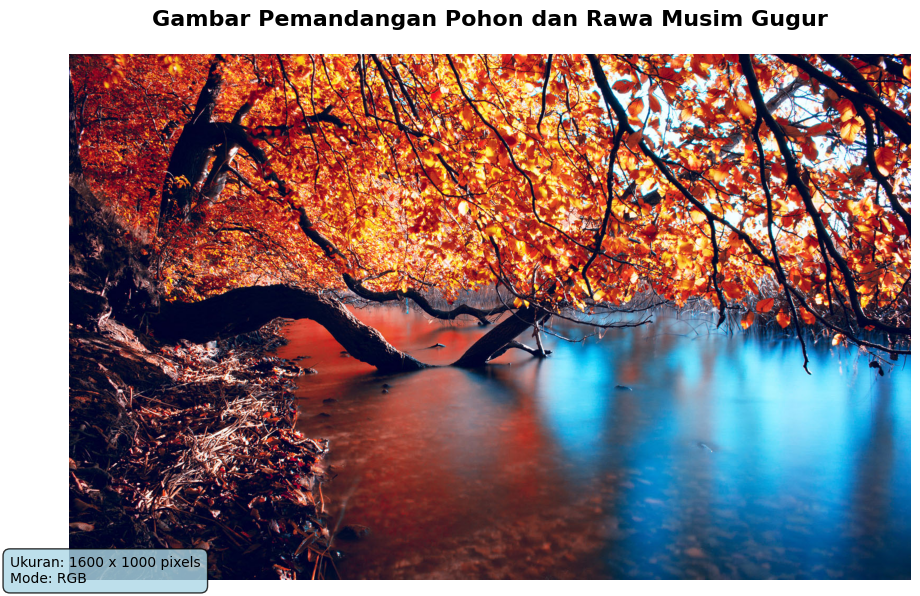

✅ Gambar berhasil ditampilkan!
📐 Resolusi: 1600 x 1000 pixels
🎨 Total pixel: 1,600,000


In [32]:
# Visualisasi Gambar dengan Matplotlib
plt.figure(figsize=(10, 6))

# Tampilkan gambar
plt.imshow(img_pil)
plt.title('Gambar Pemandangan Pohon dan Rawa Musim Gugur', fontsize=16, fontweight='bold', pad=20)

# Hilangkan axis untuk tampilan yang lebih bersih
plt.axis('off')

# Tambahkan informasi gambar sebagai text
info_text = f"Ukuran: {img_pil.size[0]} x {img_pil.size[1]} pixels\nMode: {img_pil.mode}"
plt.figtext(0.02, 0.02, info_text, fontsize=10, 
           bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))

# Tampilkan dengan layout yang rapi
plt.tight_layout()
plt.show()

print("✅ Gambar berhasil ditampilkan!")
print(f"📐 Resolusi: {img_pil.size[0]} x {img_pil.size[1]} pixels")
print(f"🎨 Total pixel: {img_pil.size[0] * img_pil.size[1]:,}")

---

Dari gambar yang ditampilkan terdapat objek pohon dan bagian-bagiannya seperti batang, ranting, akar, daun. Ada objek rawa, tanah gambut (asumsi), dan sedikit gambaran langit di sela sela potongan daun. Warna dominan ada coklat kemerahan khas gugur, warna hitam kecoklatan, biru langit. Kondisi pencahayaan cukup terang seperti gambar diambil pada pagi menuju siang dan warna cukup terepresentasi dengan jelas dengan tingkat kecerahan yang baik. Untuk ukuran gambar 1600x1000 pixel dengan jumlah pixelnya adalah 1.600.000 pixel.

---



### B3. TODO: Informasi Dasar

**Instruksi:**
Tampilkan informasi metadata gambar:
- Dimensi (Height × Width)
- Jumlah kanal
- Tipe data (dtype)
- Mode warna (jika relevan)
- Ukuran file dalam memori

**Analisis yang diperlukan:**
Jelaskan mengapa informasi ini penting untuk tahap preprocessing atau analisis lanjutan.

---

Kode berikut digunakan untuk membaca metadata gambar secara lengkap. Pertama, informasi dasar dari PIL Image ditampilkan (ukuran, mode warna, format file). Lalu gambar dikonversi ke NumPy array untuk analisis lebih detail seperti shape, tipe data, ukuran memori, serta statistik nilai piksel (min, max, rata-rata, standar deviasi). Jika gambar berwarna (RGB), dihitung juga rata-rata intensitas tiap channel (Red, Green, Blue). Dengan begitu, kita bisa memahami baik aspek teknis (resolusi, memori) maupun karakteristik visual (dominan warna, distribusi piksel) dari gambar tersebut.

---


In [33]:
# Metadata Gambar - Informasi Lengkap
print("📋 METADATA GAMBAR")
print("=" * 50)

# Informasi dari PIL Image
print("🖼️ INFORMASI PIL IMAGE:")
print(f"📐 Ukuran (W x H): {img_pil.size[0]} x {img_pil.size[1]} pixels")
print(f"🎨 Mode warna: {img_pil.mode}")
print(f"📁 Format file: {img_pil.format if img_pil.format else 'Generated/Unknown'}")

# Konversi ke numpy array untuk analisis lebih detail
img_array = np.array(img_pil)

print("\n🔢 INFORMASI NUMPY ARRAY:")
print(f"📊 Shape (H, W, C): {img_array.shape}")
print(f"💾 Tipe data: {img_array.dtype}")
print(f"🗃️ Ukuran memori: {img_array.nbytes:,} bytes ({img_array.nbytes/1024:.1f} KB)")

# Statistik nilai pixel
print("\n📈 STATISTIK PIXEL:")
print(f"🔽 Nilai minimum: {np.min(img_array)}")
print(f"🔼 Nilai maksimum: {np.max(img_array)}")
print(f"📊 Nilai rata-rata: {np.mean(img_array):.1f}")
print(f"📏 Standar deviasi: {np.std(img_array):.1f}")

# Informasi channel
if len(img_array.shape) == 3:
    height, width, channels = img_array.shape
    print(f"\n🌈 INFORMASI CHANNEL:")
    print(f"📏 Dimensi: {height} (tinggi) x {width} (lebar) x {channels} (channel)")
    if channels == 3:
        print("🎨 Channel: Red, Green, Blue (RGB)")
        # Statistik per channel
        for i, color in enumerate(['Red', 'Green', 'Blue']):
            channel_mean = np.mean(img_array[:, :, i])
            print(f"   {color}: rata-rata = {channel_mean:.1f}")
    elif channels == 1:
        print("⚫ Channel: Grayscale")
else:
    print(f"\n⚫ GRAYSCALE IMAGE:")
    print(f"📏 Dimensi: {img_array.shape[0]} x {img_array.shape[1]}")

print(f"\n✅ Total informasi berhasil diekstrak!")
print(f"💡 Aspect ratio: {img_pil.size[0]/img_pil.size[1]:.2f} (W/H)")

📋 METADATA GAMBAR
🖼️ INFORMASI PIL IMAGE:
📐 Ukuran (W x H): 1600 x 1000 pixels
🎨 Mode warna: RGB
📁 Format file: JPEG

🔢 INFORMASI NUMPY ARRAY:
📊 Shape (H, W, C): (1000, 1600, 3)
💾 Tipe data: uint8
🗃️ Ukuran memori: 4,800,000 bytes (4687.5 KB)

📈 STATISTIK PIXEL:
🔽 Nilai minimum: 0
🔼 Nilai maksimum: 255
📊 Nilai rata-rata: 93.1
📏 Standar deviasi: 75.9

🌈 INFORMASI CHANNEL:
📏 Dimensi: 1000 (tinggi) x 1600 (lebar) x 3 (channel)
🎨 Channel: Red, Green, Blue (RGB)
   Red: rata-rata = 111.9
   Green: rata-rata = 82.6
   Blue: rata-rata = 84.8

✅ Total informasi berhasil diekstrak!
💡 Aspect ratio: 1.60 (W/H)


---

Dari gambar yang dimuat didapat metadata seperti di atas. Yaitu ukuran height 1000px dan width 1600px, jumlah kanalnya ada 3, dan tipe data uint8. Ukuran datanya hasil kali HxWxC = 1600 x 1000 x 3 = 4,8 Mb. 

Dimensi, jumlah kanal, dtype, mode warna, dan ukuran memori adalah data krusial sebelum pengolahan gambar lebih lanjut karena menentukan bagaimana gambar dapat diproses secara efektif. Dimensi dan jumlah kanal (seperti 1 untuk grayscale atau 3 untuk RGB) menetapkan resolusi dan format spasial yang diperlukan oleh model, memastikan semua gambar memiliki ukuran yang seragam. Sementara itu, dtype (misalnya uint8 atau float) dan mode warna (RGB, RGBA, L) memastikan bahwa nilai piksel berada dalam rentang yang diharapkan dan diinterpretasikan dengan benar, yang sangat penting untuk preprocessing seperti normalisasi. Terakhir, ukuran memori memungkinkan perencanaan alokasi sumber daya yang efisien, mencegah masalah kehabisan memori selama pelatihan model, terutama pada dataset besar. Bersama-sama, data-data ini membentuk fondasi yang kokoh untuk memastikan konsistensi, kompatibilitas, dan performa optimal dalam alur kerja pemrosesan gambar.

---

### B4. TODO: Histogram Warna

**Instruksi:**
Tampilkan histogram distribusi intensitas untuk channel R, G, B:
- Range: 0-255
- Plot terpisah atau overlay dengan warna sesuai channel
- Label sumbu: intensitas pixel dan frekuensi
- Legend yang jelas

**Analisis yang diperlukan:**
Analisis: channel mana yang dominan? Bagaimana kontras gambar? Seperti apa sebaran intensitasnya?

---

Kode berikut untuk menganalisa intesitas warna dalam format RGB. Channel yang ada akan dijadikan 1 dimensi dan ditampilkan dalam histogram dengan rentang 0-255. Selain memvisualisasikan dalam histogram, kode berikut jgua akan mengkalkulasi rata-rata intensitas channel yang dominan, sehingga nantinya dapat mengambil konklusi karakteristik warna dan kualitas visual gambar

---



### B4. Histogram Warna


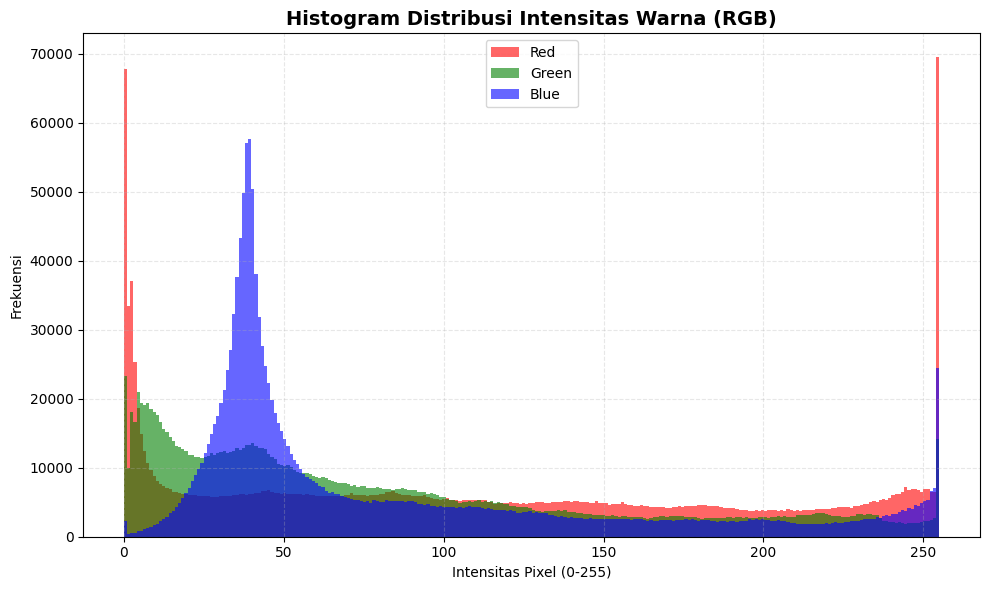

✅ Histogram warna berhasil ditampilkan.

📊 Analisis Histogram:
- Rata-rata intensitas: R=111.9, G=82.6, B=84.8
- Channel dominan: Red
- Kontras dapat dilihat dari lebar sebaran histogram (std dev per channel).
  Red: std dev = 84.1
  Green: std dev = 70.4
  Blue: std dev = 68.8
- Jika histogram menyebar luas → kontras tinggi; jika terkumpul sempit → kontras rendah.


In [ ]:
# ============================================
# B4. TODO: Histogram Warna
# ============================================
print("\n### B4. Histogram Warna")

# Pastikan gambar dalam format numpy array (RGB)
if len(img_array.shape) == 3 and img_array.shape[2] == 3:
    colors = ('Red', 'Green', 'Blue')
    plt.figure(figsize=(10, 6))
    
    # Plot histogram untuk masing-masing channel
    for i, color in enumerate(colors):
        channel_data = img_array[:, :, i].ravel()  # Flatten array
        plt.hist(channel_data, bins=256, range=(0, 255), 
                 color=color.lower(), alpha=0.6, label=color)
    
    # Label dan judul
    plt.title("Histogram Distribusi Intensitas Warna (RGB)", fontsize=14, fontweight="bold")
    plt.xlabel("Intensitas Pixel (0-255)")
    plt.ylabel("Frekuensi")
    plt.legend()
    plt.grid(alpha=0.3, linestyle="--")
    plt.tight_layout()
    plt.show()
    
    print("✅ Histogram warna berhasil ditampilkan.")
    
    # --- Analisis sederhana ---
    mean_values = [np.mean(img_array[:, :, i]) for i in range(3)]
    dominant_channel = colors[np.argmax(mean_values)]
    print("\n📊 Analisis Histogram:")
    print(f"- Rata-rata intensitas: R={mean_values[0]:.1f}, G={mean_values[1]:.1f}, B={mean_values[2]:.1f}")
    print(f"- Channel dominan: {dominant_channel}")
    print("- Kontras dapat dilihat dari lebar sebaran histogram (std dev per channel).")
    for i, color in enumerate(colors):
        print(f"  {color}: std dev = {np.std(img_array[:, :, i]):.1f}")
    print("- Jika histogram menyebar luas → kontras tinggi; jika terkumpul sempit → kontras rendah.")
    
else:
    print("⚠️ Histogram hanya tersedia untuk gambar RGB (3 channel).")


---

Hasil analisis
1. Channel dominan, nilai rata-rata intensitas paling tinggi ada pada Red (111.9) dibanding Green (82.6) dan Blue (84.8). Artinya, gambar cenderung memiliki nuansa merah yang lebih kuat.
2. Kontras gambar, standar deviasi Red (84.1) lebih besar dibanding Green (70.4) dan Blue (68.8). Ini menunjukkan sebaran nilai piksel merah lebih luas, sehingga kontras pada channel merah lebih tinggi.
3. Sebaran intensitas, histogram menunjukkan banyak piksel di area intensitas rendah hingga menengah (0–100), serta ada puncak pada nilai mendekati 255. Hal ini menandakan gambar memiliki campuran area gelap (low intensity) dan terang (high intensity), sehingga distribusinya tidak terkonsentrasi di satu titik.

Gambar didominasi oleh channel merah, dengan kontras cukup tinggi terutama pada warna merah. Warna hijau dan biru lebih rendah intensitasnya, tetapi tetap berkontribusi pada area gelap dan menengah. Secara keseluruhan, distribusi intensitas yang menyebar luas menunjukkan gambar memiliki kontras yang baik dengan variasi area gelap, sedang, dan terang. Kecerahan yang diberikan lebih menuju ke arah gelap sedang karena ada penumpukan di rentang 0-100.

---

### B5. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

**Relasi histogram dengan kesan visual:** Apa hubungan antara pola histogram yang Anda lihat dengan kesan visual gambar (terang/gelap, warna dominan, kontras)?

*Jawaban Anda:* Hubungan antara pola histogram dengan kesan visual kecerahan, warna dominan, dan kontras.
Terang/gelap atau kecerahan ditandai dari penumpukan pola warna pada rentang tertentu. Jika rentang dari 0-100 atau sebelah kiri, berarti representasi gelap pada gambar, jika semakin kekanan penumpukan pola maka semakin terang suatu gambar yang dihasilkan. Kurva Warna channel yang dominan menampilkan dominansi warna tersebuh pada gambar. Untuk tingkat kontras, jika pola histogram hampir mencakupi rentang 0-255 maka semakin kontras gambar yang dihasilkan. Jika menumpuk di tengah, tingkat kontras semakin rendah.
Untuk kasus ini warna dominannya merah, kecerahan yang sedang, dan gambar memiliki kontras yang tinggi karena pola tersebar di setip rentang.



# Bagian C — Video

### C1. Deskripsi Data

**TODO:** Jelaskan video yang akan Anda analisis:

Video Kartun beaver china tahun 1986 yang menjadi meme karean absurd, bahasa china yang membuat tidak paham kebanyakan orang, namun dapat dipahami secara emosi karena gaya bahasa tubuh dari kartun ini ketika bersumpah serapah.

- Jenis video: Meme, Ilustrasi, Kartun
- Sumber: [A better tomorrow (1986) animation of chinese beaver meme](https://youtu.be/zUkR6chwtOo?si=w7cpYH0vTwbCfyZI) (Data Publik Youtube)
- Durasi target: 19 Detik
- Alasan pemilihan: Tidak ada alasan khusus, saya mencari referensi yang lucu, karena video ini singkat dan mau lihat apa fenomena data yang terjadi pada video ini.

**Path file:** `data/video.mp4` (isi nama file Anda nanti di kode)

---

### C2. TODO: Baca & Metadata

**Instruksi:**
Baca video dengan OpenCV dan tampilkan metadata:
- Resolusi (Width × Height)
- Frame rate (fps)
- Jumlah total frame
- Durasi (detik)
- Klasifikasi resolusi (HD, Full HD, 4K, dll.)

**Analisis yang diperlukan:**
Jelaskan pentingnya parameter-parameter tersebut untuk analisis video atau aplikasi tertentu.

---

Kode berikut adalah inisialisasi modul library dan proses importnya

---


In [1]:
# Setup & Instalasi untuk Video Processing
# OpenCV dan matplotlib sudah diinstall sebelumnya, tapi pastikan tersedia
# !pip install -q opencv-python matplotlib numpy

# Import library yang dibutuhkan untuk video processing
# (beberapa sudah diimport sebelumnya untuk image processing)
print("📹 Setup Video Processing")
print("=" * 40)

# Pastikan semua library sudah tersedia
try:
    import cv2
    import matplotlib.pyplot as plt
    import numpy as np
    import os
    print("✅ OpenCV tersedia")
    print("✅ Matplotlib tersedia") 
    print("✅ NumPy tersedia")
except ImportError as e:
    print(f"❌ Error import: {e}")
    print("Jalankan: !pip install opencv-python matplotlib numpy")

# Tampilkan versi pustaka untuk video processing
print("\n📋 Versi pustaka untuk video:")
print(f"OpenCV: {cv2.__version__}")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print(f"NumPy: {np.__version__}")
print("\n✅ Setup video processing selesai!")

📹 Setup Video Processing
✅ OpenCV tersedia
✅ Matplotlib tersedia
✅ NumPy tersedia

📋 Versi pustaka untuk video:
OpenCV: 4.12.0
Matplotlib: 3.10.6
NumPy: 2.2.6

✅ Setup video processing selesai!


---

Kode berikut berfungsi untuk membaca sebuah file video, memeriksa apakah video dapat dimuat dengan benar, lalu mengekstrak informasi metadata dasarnya. Pertama, program mencoba membuka file menggunakan cv2.VideoCapture dengan disertai error handling untuk memastikan file tersedia dan formatnya didukung. Jika gagal, program akan memberikan pesan penyebab kegagalan, misalnya file tidak ditemukan atau format tidak sesuai. Jika berhasil, program kemudian mengambil metadata utama seperti resolusi (lebar, tinggi, aspect ratio), klasifikasi resolusi (SD, HD, Full HD, 4K), frame rate (FPS), jumlah frame, serta durasi video. Informasi temporal ini juga dikategorikan, misalnya 24 fps sebagai cinema rate, 30 fps standar, atau 60 fps high frame rate. Selain itu, program menghitung estimasi kebutuhan memori berdasarkan jumlah piksel per frame dengan asumsi 3 byte per piksel (RGB), lalu mengalikannya dengan total frame untuk mendapatkan perkiraan ukuran data mentah. Semua metadata ini disimpan dalam sebuah dictionary video_info agar dapat digunakan pada tahap pemrosesan berikutnya. Jika video tidak dapat dimuat, program berhenti di tahap ini dan menampilkan peringatan.

---

In [7]:
# Load Video dengan Error Handling
PATH_VIDEO = os.path.join(os.getcwd(), 'data', 'video.mp4')  # Ganti dengan path video Anda

print("📹 Mencoba membaca video...")
print(f"🎯 Target file: {PATH_VIDEO}")

# Buat objek VideoCapture
cap = cv2.VideoCapture(PATH_VIDEO)

# Periksa apakah video berhasil dibuka
if cap.isOpened():
    print("✅ Video berhasil dibuka!")
    source_info = f"✅ Berhasil memuat: {PATH_VIDEO}"
    video_loaded = True
else:
    print(f"❌ Gagal membuka video: {PATH_VIDEO}")
    
    # Cek apakah file ada
    if not os.path.exists(PATH_VIDEO):
        print(f"📁 File tidak ditemukan: {PATH_VIDEO}")
        print("\n💡 Tips:")
        print("1. Pastikan file video ada di folder 'data/'")
        print("2. Coba format MP4, AVI, atau MOV")
        print("3. Periksa nama file dan ekstensi")
    else:
        print(f"📁 File ditemukan tapi tidak bisa dibaca")
        print("💡 Kemungkinan format tidak didukung atau file rusak")
    
    source_info = f"❌ Gagal memuat: {PATH_VIDEO}"
    video_loaded = False
    
    # Bersihkan resource
    cap.release()

print(f"\n📊 Status: {source_info}")
print(f"🎬 Video loaded: {video_loaded}")

if not video_loaded:
    print("\n⚠️ PERHATIAN:")
    print("Video tidak dapat dimuat. Bagian selanjutnya akan menampilkan error.")
    print("Silakan ganti PATH_VIDEO dengan file video yang valid.")


# Metadata Video - Ekstraksi Informasi Lengkap
if video_loaded:
    print("📋 METADATA VIDEO")
    print("=" * 50)
    
    # Ambil informasi dasar dari video
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Hitung durasi (detik)
    duration = frame_count / fps if fps > 0 else 0
    
    print("📐 RESOLUSI & DIMENSI:")
    print(f"🖼️ Lebar: {width} pixels")
    print(f"🖼️ Tinggi: {height} pixels")
    print(f"📊 Resolusi: {width} × {height}")
    print(f"💡 Aspect ratio: {width/height:.2f}")
    
    # Klasifikasi resolusi
    if height >= 2160:
        res_class = "4K Ultra HD"
    elif height >= 1080:
        res_class = "Full HD (1080p)"
    elif height >= 720:
        res_class = "HD (720p)"
    else:
        res_class = "Standard Definition"
    print(f"🏷️ Klasifikasi: {res_class}")
    
    print("\n⏱️ INFORMASI TEMPORAL:")
    print(f"🎬 Frame rate: {fps:.2f} fps")
    print(f"🔢 Total frame: {frame_count:,}")
    print(f"⏰ Durasi: {duration:.2f} detik ({duration/60:.1f} menit)")
    
    # Klasifikasi frame rate
    if fps >= 60:
        fps_class = "High frame rate (smooth motion)"
    elif fps >= 30:
        fps_class = "Standard frame rate"
    elif fps >= 24:
        fps_class = "Cinema frame rate"
    else:
        fps_class = "Low frame rate"
    print(f"🏷️ Klasifikasi FPS: {fps_class}")
    
    print("\n💾 ESTIMASI DATA:")
    # Estimasi ukuran data (asumsi 3 bytes per pixel untuk RGB)
    bytes_per_frame = width * height * 3
    total_bytes = bytes_per_frame * frame_count
    print(f"📊 Bytes per frame: {bytes_per_frame:,} ({bytes_per_frame/1024/1024:.1f} MB)")
    print(f"📦 Total estimasi (RGB): {total_bytes:,} bytes ({total_bytes/1024/1024/1024:.1f} GB)")
    
    print(f"\n✅ Metadata berhasil diekstrak!")
    
    # Simpan informasi untuk digunakan nanti
    video_info = {
        'width': width,
        'height': height, 
        'fps': fps,
        'frame_count': frame_count,
        'duration': duration
    }
    
else:
    print("❌ Video tidak dimuat - tidak dapat mengekstrak metadata")
    print("Pastikan PATH_VIDEO menuju ke file video yang valid")

📹 Mencoba membaca video...
🎯 Target file: f:\mulmed\data\video.mp4
✅ Video berhasil dibuka!

📊 Status: ✅ Berhasil memuat: f:\mulmed\data\video.mp4
🎬 Video loaded: True
📋 METADATA VIDEO
📐 RESOLUSI & DIMENSI:
🖼️ Lebar: 640 pixels
🖼️ Tinggi: 360 pixels
📊 Resolusi: 640 × 360
💡 Aspect ratio: 1.78
🏷️ Klasifikasi: Standard Definition

⏱️ INFORMASI TEMPORAL:
🎬 Frame rate: 30.00 fps
🔢 Total frame: 593
⏰ Durasi: 19.77 detik (0.3 menit)
🏷️ Klasifikasi FPS: Standard frame rate

💾 ESTIMASI DATA:
📊 Bytes per frame: 691,200 (0.7 MB)
📦 Total estimasi (RGB): 409,881,600 bytes (0.4 GB)

✅ Metadata berhasil diekstrak!


---

Dari video yang dimuat, metadata berhasil dijadikan informasi yaitu
1. Resolusi dari video adalah width 640px dan height 360px.
2. Hasil Frame Per Second-nya adalah 30 FPS
3. Total Frame sebanyak 593 frame
4. Rentang waktu 19,77 detik
5. Diklasifikasikan ke dalam resolusi Standart Resolution (SD) karena standar resolusinya masih 360 pixel, butuh >720 untuk HD.

Apa pentingnya parameter-parameter ini? Parameter ini penting untuk menentukan kualitas dan kebutuhan komputasi, dan kesesuiaan penggunaa. Karena video ini tidak terlalu memiliki kebutuhan analisis tinggi, dan bukan bertujuan saintis, makanya video yang dicapture hanya beresolusi rendah saja. Resolusi (Width × Height) berhubungan langsung dengan detail visual, semakin tinggi resolusi, semakin tajam gambar yang dihasilkan, sehingga bermanfaat untuk aplikasi yang membutuhkan ketelitian seperti pengawasan CCTV, analisis medis, atau pengenalan wajah, meskipun konsekuensinya adalah kebutuhan penyimpanan dan pemrosesan yang lebih besar. FPS menentukan kelancaran video dalam perputaran videonya. 3o fps menjadi frame rate standar untuk video digital, dan 60 fps untuk kebutuhan yang lebih tinggi seperti olahraga, dan gaming. Dengan demikian, setiap parameter memiliki peran strategis dalam menyeimbangkan kualitas visual, performa teknis, serta efisiensi sumber daya dalam berbagai aplikasi video.

---

### C3. TODO: Tampilkan 3 Frame (Awal–Tengah–Akhir)

**Instruksi:**
Ambil dan tampilkan 3 frame representatif:
- Frame pertama (index 0)
- Frame tengah (index ~total_frame/2)
- Frame terakhir (index total_frame-1)
- **Konversi BGR→RGB** sebelum ditampilkan
- Subplot dengan judul frame dan timestamp

**Analisis yang diperlukan:**
Deskripsikan perbedaan visual antar frame dan apa yang dapat dipelajari dari sampel frame ini.

---

Kode ini bertujuan untuk mengekstrak dan menampilkan tiga frame representatif dari sebuah video dengan cara yang rapi dan modular. Pertama, video dibuka menggunakan OpenCV (cv2.VideoCapture), lalu diambil metadata seperti resolusi, FPS, dan jumlah total frame. Tipe warna masih BGR dan tiga frame yang diambil adalah frame pertama, frame tengah, dan frame terakhir. Fungsi extract_frame() mengatur posisi frame, membaca frame, dan mengonversi warnanya dari BGR ke RGB agar tampil benar di matplotlib. Frame-frame ini kemudian ditampilkan berdampingan menggunakan display_frames(), dengan subplot, judul, dan kotak yang menunjukkan timestamp (detik) masing-masing frame. Setelah selesai, resource video dibersihkan dengan cap.release(). Struktur modular ini membuat kode lebih ringkas, mudah dibaca, dan fleksibel untuk menambah frame lain jika diperlukan.
Akan ada visualisasi BGR dan RGB sebelum proses konvers warna.

---


📹 Mengekstrak dan menampilkan frame...


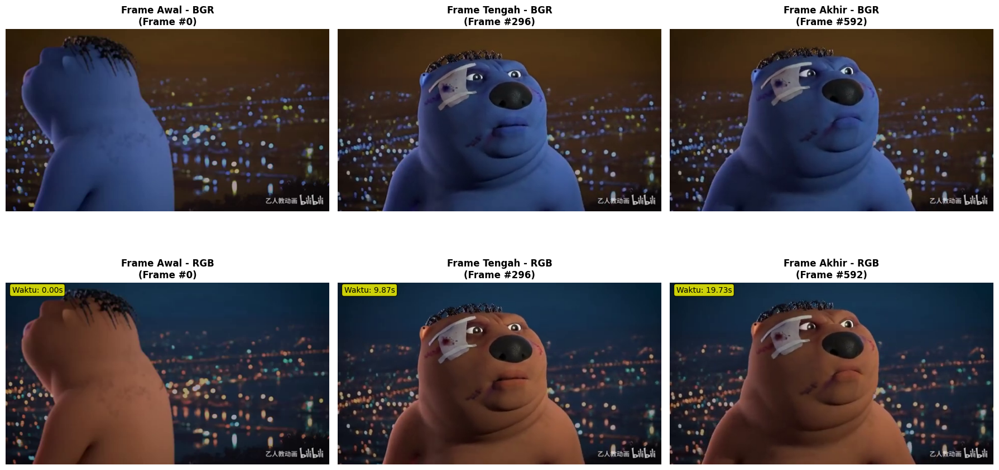

✅ Frame berhasil diekstrak!
📊 Resolusi frame: 640 × 360
🎯 Frame yang diekstrak:
   Frame Awal: Frame #0 (waktu 0.00s)
   Frame Tengah: Frame #296 (waktu 9.87s)
   Frame Akhir: Frame #592 (waktu 19.73s)

💡 Total frame berhasil diekstrak: 3
🔄 Video capture resource dibersihkan


In [8]:
# Visualisasi Frame BGR & RGB dari Video
if video_loaded:
    print("📹 Mengekstrak dan menampilkan frame...")

    # Tentukan frame yang akan diekstrak
    frame_first = 0
    frame_middle = frame_count // 2
    frame_last = max(0, frame_count - 1)

    frames_to_extract = [
        (frame_first, "Frame Awal"),
        (frame_middle, "Frame Tengah"),
        (frame_last, "Frame Akhir")
    ]

    # Setup plot dengan 2 baris: BGR (atas) dan RGB (bawah)
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    extracted_frames_bgr = []
    extracted_frames_rgb = []

    for i, (frame_idx, title) in enumerate(frames_to_extract):
        # Set posisi frame
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)

        # Baca frame
        ret, frame = cap.read()

        if ret:
            # Simpan frame BGR
            extracted_frames_bgr.append(frame)

            # Konversi ke RGB
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            extracted_frames_rgb.append(frame_rgb)

            # Tampilkan frame BGR (atas)
            axes[0, i].imshow(frame)
            axes[0, i].set_title(f'{title} - BGR\n(Frame #{frame_idx})', fontsize=12, fontweight='bold')
            axes[0, i].axis('off')

            # Tampilkan frame RGB (bawah)
            axes[1, i].imshow(frame_rgb)
            axes[1, i].set_title(f'{title} - RGB\n(Frame #{frame_idx})', fontsize=12, fontweight='bold')
            axes[1, i].axis('off')

            # Tambahkan informasi timestamp di bawah RGB
            timestamp = frame_idx / fps
            axes[1, i].text(0.02, 0.98, f'Waktu: {timestamp:.2f}s',
                            transform=axes[1, i].transAxes, fontsize=10,
                            bbox=dict(boxstyle="round,pad=0.3", facecolor="yellow", alpha=0.8),
                            verticalalignment='top')

        else:
            # Jika gagal membaca frame
            for row in range(2):
                axes[row, i].text(0.5, 0.5, f'❌ Gagal\nmembaca\n{title}',
                                  transform=axes[row, i].transAxes, fontsize=12,
                                  horizontalalignment='center', verticalalignment='center')
                axes[row, i].set_title(f'{title} (Error)', fontsize=12)
                axes[row, i].axis('off')

    plt.tight_layout()
    plt.show()

    # Informasi ekstraksi
    print(f"✅ Frame berhasil diekstrak!")
    print(f"📊 Resolusi frame: {width} × {height}")
    print(f"🎯 Frame yang diekstrak:")
    for frame_idx, title in frames_to_extract:
        timestamp = frame_idx / fps
        print(f"   {title}: Frame #{frame_idx} (waktu {timestamp:.2f}s)")

    print(f"\n💡 Total frame berhasil diekstrak: {len(extracted_frames_bgr)}")

    # Bersihkan resource video capture
    cap.release()
    print("🔄 Video capture resource dibersihkan")

else:
    print("❌ Tidak dapat menampilkan frame - video tidak dimuat")
    print("Pastikan PATH_VIDEO menuju ke file video yang valid")

    # Tampilkan placeholder
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    for row in range(2):
        for i, title in enumerate(["Frame Awal", "Frame Tengah", "Frame Akhir"]):
            axes[row, i].text(0.5, 0.5, f'❌ Video\ntidak dimuat\n\n{title}',
                               transform=axes[row, i].transAxes, fontsize=12,
                               horizontalalignment='center', verticalalignment='center')
            axes[row, i].set_title(f'{title} (No Video)', fontsize=12)
            axes[row, i].axis('off')

    plt.tight_layout()
    plt.show()


---

Hasil dari visualisasi terdapat 3 frame yaitu fram pertama, tengah dan terakhir
Frame Awal -  Frame 0 di detik 0.00
Frame Tengah -  Frame 296 di detik 9.87
Frame Akhir -  Frame 592 di detik 19.73
Konversi warna BGR Ke RGB dengen fungsi cv2.cvtColor(frame, cv2.COLOR_BGR2RGB) akan mengubah struktur warna BGR menjadi RGB.
Dapat dilihat BGR yang divisualisasikan RGB akan mengubah strukut tipe warnanya, yang biru sebenarnya menjadi merah, hijau tetap dan merah sebenarnya menjadi biru. Bisa dilihat pertukaran warna langit dan kulit berang-berang pada ketiga frame.

Ada perbedaan yang mencolok dari frame pertama dengan yang lain. Yaitu frame pertama merupakan frame awal yang posisi badan berang-berang ancang-ancang memutar. Posisi badan yang berbeda dengan frame kedua dan ketiga yang dudah menghadap depan, dengan posisi wajah menoleh ke kanan (prespektif pembaca). Frame kedua dan ketiga hanya berbeda mimik wajah khususnya mulut, transisi berbicara saat mulai dan selesai.

---

### C4. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

**Kesesuaian parameter:** Apakah fps dan resolusi video ini sesuai untuk use case pilihan Anda (misalnya: media sosial, kuliah daring, presentasi, dll.)? Jelaskan alasan singkat.

*Jawaban Anda:* Video ini memiliki resolusi 30 fps, dan resolusi layar 360p, sehingga untuk kebutuhan media sosial mungkin masih cocok untuk short video, yang portrait, namun untuk long video sudah tergolong rendah. Untuk kuliah daring mungkin sudah cukup mengingat 30fps sudah standar karena mengingat kemampuan internet indonesia yang secara langsung mengakses informasi alias live streaming, hanya mampu di 1080p, menurut saya 360p masih cukup untuk tayangan kuliah daring. Namun jika dijadikan video dokumenter, tampilan game pc, video profesional, 30 fps dan resolusi SD tidak mungkin untuk pasarnya karena akan sangat terbatas informasi yang disampaikan dengan baik, dan cepat dimuat ke pengalaman pengguna. Jadi video dengan resolusi SD dan 30 fps masih relevan untuk daerah yang memiliki bandwidth jaringan rendah, dan yang berbasis live informasi, namun buruk untuk industri profesional karean membutuhkan visual yang bagus dan kelancaran video yang baik.

# Perbandingan & Kesimpulan

## Perbandingan Representasi Media

**TODO:** Bandingkan secara ringkas representasi dan visualisasi ketiga media:

### Audio (1D - Temporal)
- Representasi: Lagu Don't Let Me Down by The Beatles (Frekuensi vs Waktu, Amplitudo vs Waktu, Koefisien MFCC vs Waktu)
- Visualisasi utama: Waveform, Spectogram, MFCC
- Informasi yang diperoleh: Terdapat banyak perubahan frekuensi dan warna koefisien MFCC dari data audio ini, yang menandakan perpaduan suara yang beragam, dan pola beat yang berbeda dari setiap bagian musik (chorus dan verse)

### Gambar (2D - Spasial)  
- Representasi: Gambar Pemandangan Pohon dan Rawa Musim Gugur (Frekuensi Warna vs Pixel (RGB))
- Visualisasi utama: Histogram
- Informasi yang diperoleh: Pola Histogram dari Frekuensi Warna yang tersebar di rentang RGB 0-255 melambangkan hubungan kecerahan, kontras, dan intesitas warna.

### Video (2D + Waktu - Spatio-temporal)
- Representasi: Urutan frame 2D (lebar × tinggi) per waktu; setiap frame terdiri dari pixel RGB/BGR, membentuk matriks 3D (H × W × C) yang berubah seiring waktu.

- Visualisasi utama: Playback video, ekstraksi frame (awal, tengah, akhir), histogram warna per frame, serta plotting BGR/RGB untuk analisis warna.

- Informasi yang diperoleh: Resolusi, frame rate (fps), durasi, aspek rasio, kontras, dominansi warna per frame, estimasi ukuran data, serta pola perubahan visual dan warna sepanjang waktu.
---

## Refleksi Pembelajaran

### 3 Poin yang Saya Pelajari:
1. Saya bisa melihat warna audio dengan Penerapan Koefisien MFCC, dan mengidentifikasikan frekuensi dengan Spectogram.
2. Korelasi pola histogram pada kecerahan, dominasi warna dan kekontrasan gambar yang dihasilkan 
3. Format BGR dan RGB dalam pengolahan gambar

### 2 Hal yang Masih Membingungkan/Ingin Diperdalam:
1. Ingin memperdalam tentang hipotesa terhadap suatu audio dari data spectogram berdasarkan frekuensi

---

## Sumber Data & Referensi

**TODO:** Cantumkan semua sumber data dan referensi yang digunakan:

- **Audio:** [Dont Let Me Down by The Beatles](https://youtu.be/NCtzkaL2t_Y?si=LewSK6UpAJ7IENAn)
- **Gambar:** [Gambar Pemandangan Pohon dan Rawa Musim Gugur](https://blogger.googleusercontent.com/img/b/R29vZ2xl/AVvXsEgz47dVLVX2xndNwJXoZ70nrE_bXqc4U6fr8lJaTbB9O82oA5jhLTtR8wmeDCKJ_GbS6maRHOBFfSi_P8JFoZbZkbKmjiDWeCLcEZy44Wccd0rACsFkZKmBJmDOAjVSKy5cxyFzGKwLKVKl/s1600/Photography+Wallpapers+for+Desktop+%25281%2529.jpg)
- **Video:** - [A better tomorrow (1986) animation of chinese beaver meme](https://youtu.be/zUkR6chwtOo?si=w7cpYH0vTwbCfyZI)

- **Referensi teknis:** 
1. https://chatgpt.com/share/68c80a9e-4640-8009-954f-e622425f0a20
2. https://www.geeksforgeeks.org/nlp/mel-frequency-cepstral-coefficients-mfcc-for-speech-recognition/
3. https://www.datalearns247.com/visualisasi-dengan-matplotlib-histogram-522
4. https://chatgpt.com/share/68c81b86-e2b4-8009-80e3-dcf3482baa42
5. https://chatgpt.com/share/68c83040-c174-8009-b9d6-43cef8aeed9b
6. https://github.com/informatika-itera/IF25-40305-handson/blob/main/2_loading_media_image_vid.ipynb
7. https://github.com/informatika-itera/IF25-40305-handson/blob/main/1_loading_media_audio.ipynb

# Rubrik Penilaian

## Distribusi Bobot Penilaian

| **Aspek Penilaian** | **Bobot** | **Deskripsi** |
|---|---|---|
| **Kelengkapan** | **35%** | Semua langkah inti dikerjakan sesuai checklist |
| **Kualitas Visualisasi** | **20%** | Judul, label sumbu, colorbar, legend, keterbacaan plot |
| **Analisis & Interpretasi** | **30%** | Kemampuan interpretasi hasil, bukan sekadar output mentah |
| **Kerapihan & Struktur** | **10%** | Markdown jelas, kode modular, dokumentasi baik |
| **Orisinalitas & Penguasaan** | **5%** | Pemahaman saat presentasi acak |

---

## Detail Kriteria Penilaian

### 🏆 Kelengkapan (35%)
- ✅ Semua 4 visualisasi audio (metadata, waveform, spectrogram, MFCC)
- ✅ Semua 3 visualisasi gambar (display RGB, metadata, histogram)  
- ✅ Semua 2 visualisasi video (metadata, frame extraction)
- ✅ Analisis ringkas untuk setiap bagian

### 📊 Kualitas Visualisasi (20%)
- Plot memiliki judul yang informatif dan deskriptif
- Label sumbu X dan Y jelas dan sesuai
- Colorbar/legend tersedia jika diperlukan
- Ukuran plot proporsional dan mudah dibaca

### 🧠 Analisis & Interpretasi (30%)
- Interpretasi menunjukkan pemahaman konsep
- Analisis kontekstual, bukan sekadar deskripsi output
- Mampu menghubungkan hasil dengan teori
- Refleksi pembelajaran yang thoughtful

### 📝 Kerapihan & Struktur (10%)
- Markdown terstruktur dengan heading yang konsisten
- Kode bersih, terkompartemen, dan mudah dibaca
- Dokumentasi yang memadai
- Flow logical dari satu bagian ke bagian lain

### 🎯 Orisinalitas & Penguasaan (5%)
- **PENTING:** Jika saat presentasi acak Anda tidak mampu menjelaskan kode yang Anda tulis atau menunjukkan ketergantungan buta pada AI/copy-paste, **nilai tugas akan dianggap 0**.
- Kemampuan menjelaskan logika dan alur pemikiran
- Pemahaman konsep di balik implementasi kode

## Proporsi Penilaian Total
- Proporsi penilaian hanya 80%, 20% lagi akan didasarkan pada kecepatan pengumpulan tugas
- Sehingga: 0.8 * penilaian dosen + nilai waktu pengumpulan

# Aturan Kejujuran Akademik

## 📖 Penggunaan Referensi & AI yang Diperbolehkan

Anda **BOLEH** menggunakan:
- ✅ Dokumentasi resmi library (NumPy, Matplotlib, Librosa, OpenCV)
- ✅ Tutorial dan contoh kode dari sumber terpercaya
- ✅ AI tools (ChatGPT, GitHub Copilot, dll.) sebagai **alat bantu pembelajaran**
- ✅ Diskusi dengan teman untuk pemahaman konsep

## ⚠️ Syarat & Batasan WAJIB

Namun Anda **HARUS**:
- 🧠 **Memahami setiap baris kode** yang Anda masukkan ke notebook
- 📝 **Menulis interpretasi dengan kata-kata sendiri**, bukan hasil copy-paste
- 📚 **Mencantumkan sumber data dan referensi** yang digunakan, termasuk transkrip percakapan dengan AI dalam link atau teks
- 🎯 **Mampu menjelaskan logika dan alur pemikiran** saat presentasi acak

## ❌ Pelanggaran yang Berakibat Nilai 0

- **Plagiarisme atau penyalinan buta** dari sumber manapun
- **Copy-paste kode tanpa pemahaman** dan tidak dapat menjelaskan
- **Menggunakan AI untuk mengerjakan seluruh tugas** tanpa pembelajaran personal
- **Tidak dapat menjawab pertanyaan dasar** tentang kode yang dikumpulkan
- **Menyalin pekerjaan teman** atau bekerjasama dalam pengerjaan individual

## 🎯 Persiapan Presentasi Acak

**Kemungkinan pertanyaan yang akan ditanyakan:**
- "Jelaskan mengapa Anda menggunakan parameter ini di STFT?"
- "Apa arti dari pola yang terlihat di MFCC?"
- "Mengapa perlu konversi BGR ke RGB?"
- "Interpretasikan hasil histogram yang Anda buat"
- "Bagaimana cara kerja spectrogram?"

**Tips sukses:**
- Pahami konsep dasar setiap teknik yang digunakan
- Latih menjelaskan dengan bahasa sederhana
- Siapkan justifikasi untuk setiap pilihan parameter
- Kuasai interpretasi setiap visualisasi yang dibuat

# Panduan Pengumpulan

## 📁 Berkas yang Harus Dikumpulkan

### Wajib:
1. **Notebook Jupyter** (.ipynb) dengan nama: `NIM_Nama_TugasMultimedia.ipynb`
   - Contoh: `123456789_JohnDoe_TugasMultimedia.ipynb`
2. **PDF hasil render dari notebook**

---

## 📅 Informasi Pengumpulan

---

## ✅ Checklist Sebelum Submit

- [✅] Semua cell sudah dijalankan dan menampilkan output
- [✅] Nama file sesuai format: `NIM_Worksheet2.ipynb` dan `NIM_Worksheet2.pdf`
- [✅]Semua TODO sudah diisi dengan lengkap
- [✅] Analisis dan interpretasi sudah ditulis untuk setiap bagian
- [✅] Sumber data dan referensi sudah dicantumkan

---

### Export ke PDF:
- File → Save and Export Notebook As →  HTML
- Buka HTML di browser -> Save as PDF